<a href="https://colab.research.google.com/github/Chloe0704/Admission_Visualization/blob/master/world_food_facts_features.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# World Food Facts

* Original Data Source:  https://www.kaggle.com/openfoodfacts/world-food-facts
* Modified Source:  https://www.kaggle.com/lwodarzek/nutrition-table-clustering/output

### Setup Tasks 

#### Install Latest Plotly

In [0]:
import plotly
plotly.__version__

'3.6.1'

In [0]:
!pip uninstall -q -y plotly
!pip install plotly==3.6.0

    100% |████████████████████████████████| 31.1MB 999kB/s 
  Stored in directory: /root/.cache/pip/wheels/67/0b/29/08c7f5caed2d1ac446db982ff607b326d49bfa0bd3a67ef8c7
  Stored in directory: /root/.cache/pip/wheels/d7/a9/33/acc7b709e2a35caa7d4cae442f6fe6fbf2c43f80823d46460c
Successfully built plotly retrying


In [0]:
import plotly
plotly.__version__

'3.6.0'

In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

# Ingest

In [0]:
import pandas as pd

In [0]:
df = pd.read_csv(
    "https://raw.githubusercontent.com/noahgift/food/master/data/features.en.openfoodfacts.org.products.csv")
df.drop(["Unnamed: 0", "exceeded", "g_sum", "energy_100g"], axis=1, inplace=True) #drop two rows we don't need
df = df.drop(df.index[[1,11877]]) #drop outlier
df.rename(index=str, columns={"reconstructed_energy": "energy_100g"}, inplace=True)
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole)
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola


# EDA

In [0]:
#Rows and Attributes
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

In [0]:
df.shape

(45026, 7)

### Sorting

#### Sort by One Column:  Protein

In [0]:
df.sort_values(by=["proteins_100g"], ascending=False).head(10)

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
2377,0.00,0.00,0.00,100.00,0.00000,1700.00,Unflavored Gelatin
37027,0.00,0.00,0.00,100.00,0.36322,1700.00,Unflavored Gelatin
16674,6.82,22.73,13.64,86.36,14.77772,2120.51,"Fisherman's Wharf, Cocktail Shrimp"
37415,3.33,6.67,3.33,83.33,0.67818,1659.87,"Whey & Soy Protein, Flavored Drink Mix, Vanilla"
133,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke 500 Gramm Vanilla
131,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke 1000 Gramm Vanilla
129,4.60,8.80,6.00,78.05,1.21158,1655.85,Whey Protein aus Molke Vanilla
33115,1.67,13.33,0.00,76.67,0.00000,1595.13,Vital Wheat
37392,6.25,8.33,4.17,75.00,0.63500,1660.36,"Whey Protein Powder, Chocolate"
16669,5.36,21.43,14.29,67.86,12.79144,1726.97,"Fisherman's Wharf, Cocktail Shrimp"


#### Sort by Two Columns:  Sugar, Salt

In [0]:
df.sort_values(by=["sugars_100g", "salt_100g"], ascending=[False, False]).head(10)

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product
33151,0.0,0.0,100.0,0.0,71.1200,0.0,"Turkey Brine Kit, Garlic & Herb"
24783,0.0,100.0,100.0,0.0,24.1300,1700.0,Seasoning
4073,0.0,100.0,100.0,0.0,7.6200,1700.0,"Seasoning Rub, Sweet & Spicy Seafood"
10282,0.0,100.0,100.0,0.0,2.5400,1700.0,Instant Pectin
17880,0.0,100.0,100.0,0.0,0.6350,1700.0,Cranberry Cosmos Cocktail Rimming Sugar
8822,0.0,100.0,100.0,0.0,0.5588,1700.0,"Alaga, The Original Cane Flavor Syrup, Cane"
8823,0.0,100.0,100.0,0.0,0.5588,1700.0,The Original Cane Syrup
41157,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela Brown Sugar Cane
41158,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela Brown Sugar Cane
41159,0.0,100.0,100.0,0.0,0.3175,1700.0,Panela


## Visualizations

In [0]:
df.describe()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
count,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000
mean,10.765991,34.054064,16.005077,6.617261,1.469681,1111.286193
std,14.930295,29.557393,21.495731,7.926242,12.795225,791.608595
min,0.000000,0.000000,-1.200000,-3.570000,0.000000,0.000000
25%,0.000000,7.440000,1.570000,0.000000,0.063500,334.520000
50%,3.170000,22.390000,5.880000,4.000000,0.635000,1121.540000
75%,17.860000,61.540000,23.080000,9.520000,1.440180,1678.460000
max,100.000000,100.000000,100.000000,100.000000,2032.000000,4475.000000


### Histogram

Generate distributions based on energy type

In [0]:
med = 0.635

df['salt_100g'] = df.apply(lambda x: med if ( x.salt_100g > 100) else x.salt_100g,axis = 1)

In [0]:
df.describe()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g
count,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000,45026.000000
mean,10.765991,34.054064,16.005077,6.617261,1.332332,1111.286193
std,14.930295,29.557393,21.495731,7.926242,4.156048,791.608595
min,0.000000,0.000000,-1.200000,-3.570000,0.000000,0.000000
25%,0.000000,7.440000,1.570000,0.000000,0.063500,334.520000
50%,3.170000,22.390000,5.880000,4.000000,0.635000,1121.540000
75%,17.860000,61.540000,23.080000,9.520000,1.440180,1678.460000
max,100.000000,100.000000,100.000000,100.000000,99.905820,4475.000000


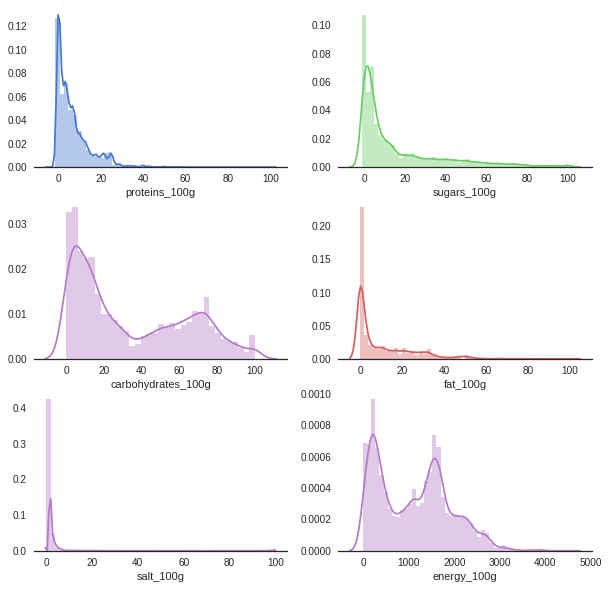

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)
sns.set(style="white", palette="muted", color_codes=True)


# Set up the matplotlib figure
f, axes = plt.subplots(3, 2, figsize=(10, 10))#, sharex=True)
sns.despine(left=True)

# Plot a simple histogram with binsize determined automatically
sns.distplot(df.proteins_100g, color="b", ax=axes[0, 0])
sns.distplot(df.sugars_100g, color="g", ax=axes[0, 1])
sns.distplot(df.fat_100g, color="r", ax=axes[1, 1])
sns.distplot(df.carbohydrates_100g, color="m", ax=axes[1, 0])
sns.distplot(df.salt_100g, color="m", ax=axes[2, 0])
sns.distplot(df.energy_100g, color="m", ax=axes[2, 1])

### Word Cloud

In [0]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

#### High protein foods

Find protein foods in the 98th percentile

In [0]:
high_protein_df = df[df.proteins_100g > df.proteins_100g.quantile(.98)]
high_protein_text = high_protein_df['product'].values
len(high_protein_text)

896

Word Cloud High Protein

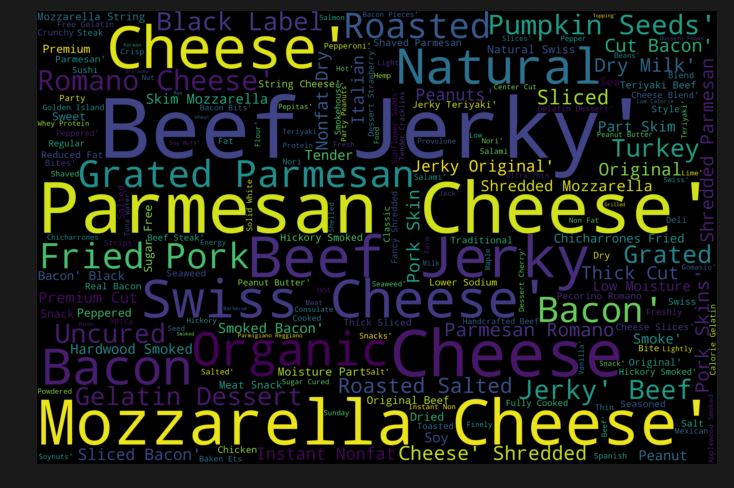

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_protein_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High fat foods

Find fatty foods in the 98th percentile

In [0]:
high_fat_df = df[df.fat_100g > df.fat_100g.quantile(.98)]
high_fat_text = high_fat_df['product'].values
len(high_fat_text)

878

Word Cloud High Fat

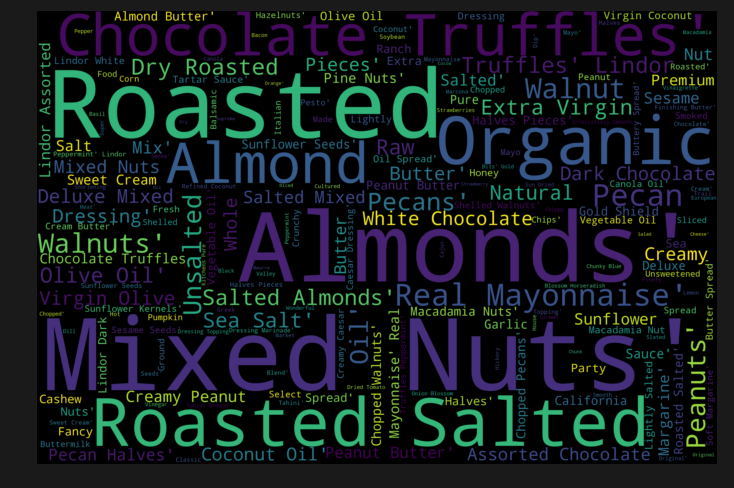

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_fat_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#### High sugar foods

Find sugary foods in the 98th percentile

In [0]:
high_sugar_df = df[df.sugars_100g > df.sugars_100g.quantile(.98)]
high_sugar_text = high_sugar_df['product'].values
len(high_sugar_text)

893

Word Cloud High Sugar

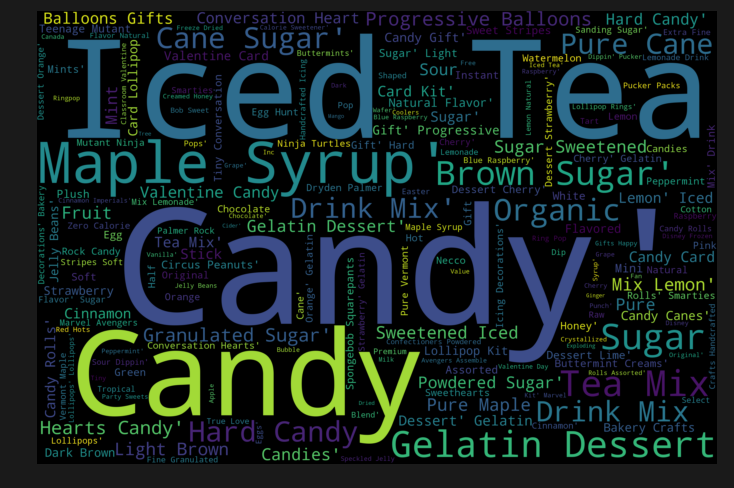

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(high_sugar_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

# Model Building 

## Clustering

In [0]:
df.columns

Index(['fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g',
       'salt_100g', 'energy_100g', 'product'],
      dtype='object')

### Create Features to Cluster

In [0]:
df_cluster_features = df.drop("product", axis=1)

### Scale the data

In [0]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(df_cluster_features))
print(scaler.transform(df_cluster_features))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[2.85700000e-01 6.42900000e-01 1.53063241e-01 6.89388819e-02
  0.00000000e+00 5.06782123e-01]
 [5.71400000e-01 1.78600000e-01 4.71343874e-02 2.06913199e-01
  1.22543411e-02 6.33675978e-01]
 [1.87500000e-01 5.78100000e-01 1.66205534e-01 1.70223038e-01
  1.39831693e-03 4.36433520e-01]
 ...
 [0.00000000e+00 1.33300000e-01 1.43577075e-01 3.44694410e-02
  3.81359164e-04 5.06391061e-02]
 [0.00000000e+00 1.62500000e-01 1.72430830e-01 3.44694410e-02
  3.81359164e-04 6.17318436e-02]
 [0.00000000e+00 0.00000000e+00 1.18577075e-02 3.44694410e-02
  0.00000000e+00 0.00000000e+00]]


###PCA

In [0]:
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.decomposition import PCA

In [0]:
df_cluster_features.dropna(axis=0, how='any', inplace=True)
df_cluster_features.info()

<class 'pandas.core.frame.DataFrame'>
Index: 45026 entries, 0 to 45027
Data columns (total 7 columns):
fat_100g              45026 non-null float64
carbohydrates_100g    45026 non-null float64
sugars_100g           45026 non-null float64
proteins_100g         45026 non-null float64
salt_100g             45026 non-null float64
energy_100g           45026 non-null float64
cluster               45026 non-null int32
dtypes: float64(6), int32(1)
memory usage: 2.6+ MB


In [0]:
pca = PCA(n_components=3)
pca.fit(df_cluster_features)
print(pca.explained_variance_ratio_)
print(pca.explained_variance_)

[9.98163484e-01 1.42390016e-03 3.11822934e-04]
[6.27129469e+05 8.94612725e+02 1.95913149e+02]


In [0]:
df_pca = pca.transform(df_cluster_features)
df_pca = pd.DataFrame(df_pca)
df_pca.columns = ['PC1','PC2','PC3','PC4','PC5']
df_pca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45026 entries, 0 to 45025
Data columns (total 5 columns):
0    45026 non-null float64
1    45026 non-null float64
2    45026 non-null float64
3    45026 non-null float64
4    45026 non-null float64
dtypes: float64(5)
memory usage: 1.7 MB


In [0]:
pca.components_

array([[ 1.44761822e-02,  2.16827229e-02,  8.90214999e-03,
         3.90796559e-03, -7.64425209e-05,  9.99612812e-01],
       [ 2.83313994e-01, -7.67703680e-01, -5.62056859e-01,
         1.18753415e-01,  7.86409177e-03,  1.70912500e-02],
       [ 2.67391917e-01, -5.10673284e-01,  8.10251877e-01,
        -1.02732369e-01, -2.55375318e-02,  3.88662343e-04],
       [-3.51513901e-01, -1.08332819e-01,  1.64504180e-01,
         9.14888273e-01,  2.47797970e-02,  2.40056072e-03],
       [ 1.33209204e-02, -4.32079035e-03,  2.10501826e-02,
        -2.62452992e-02,  9.99335753e-01, -1.07625656e-04]])

### Cluster Diagnostics

**Three **clusters seem ideal

##### Yellowbrick Visualizer Elbow Method

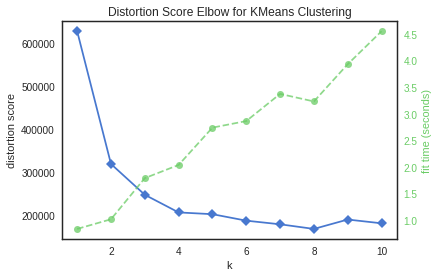

In [0]:
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(1,11))

visualizer.fit(df_cluster_features)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

##### Yellowbrick Silhouette Visualizer


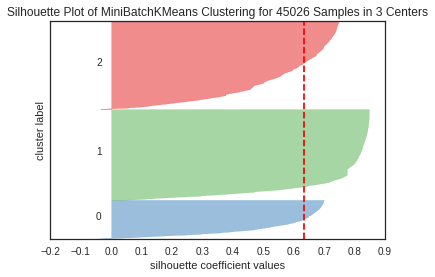

In [0]:
from sklearn.cluster import MiniBatchKMeans

from yellowbrick.cluster import SilhouetteVisualizer

# Instantiate the clustering model and visualizer
model = MiniBatchKMeans(3)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(df_cluster_features) # Fit the training data to the visualizer
visualizer.poof() # Draw/show/poof the data

### Add Cluster Labels

In [0]:
from sklearn.cluster import KMeans

k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(df_cluster_features))
df['cluster'] = kmeans.labels_
df_cluster_features['cluster'] = kmeans.labels_
df.head()

,fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,energy_100g,product,cluster
0,28.57,64.29,14.29,3.57,0.00000,2267.85,Banana Chips Sweetened (Whole),0
2,57.14,17.86,3.57,17.86,1.22428,2835.70,Organic Salted Nut Mix,0
3,18.75,57.81,15.62,14.06,0.13970,1953.04,Organic Muesli,0
4,36.67,36.67,3.33,16.67,1.60782,2336.91,Zen Party Mix,0
5,18.18,60.00,21.82,14.55,0.02286,1976.37,Cinnamon Nut Granola,0


###Pairplot for Cluster

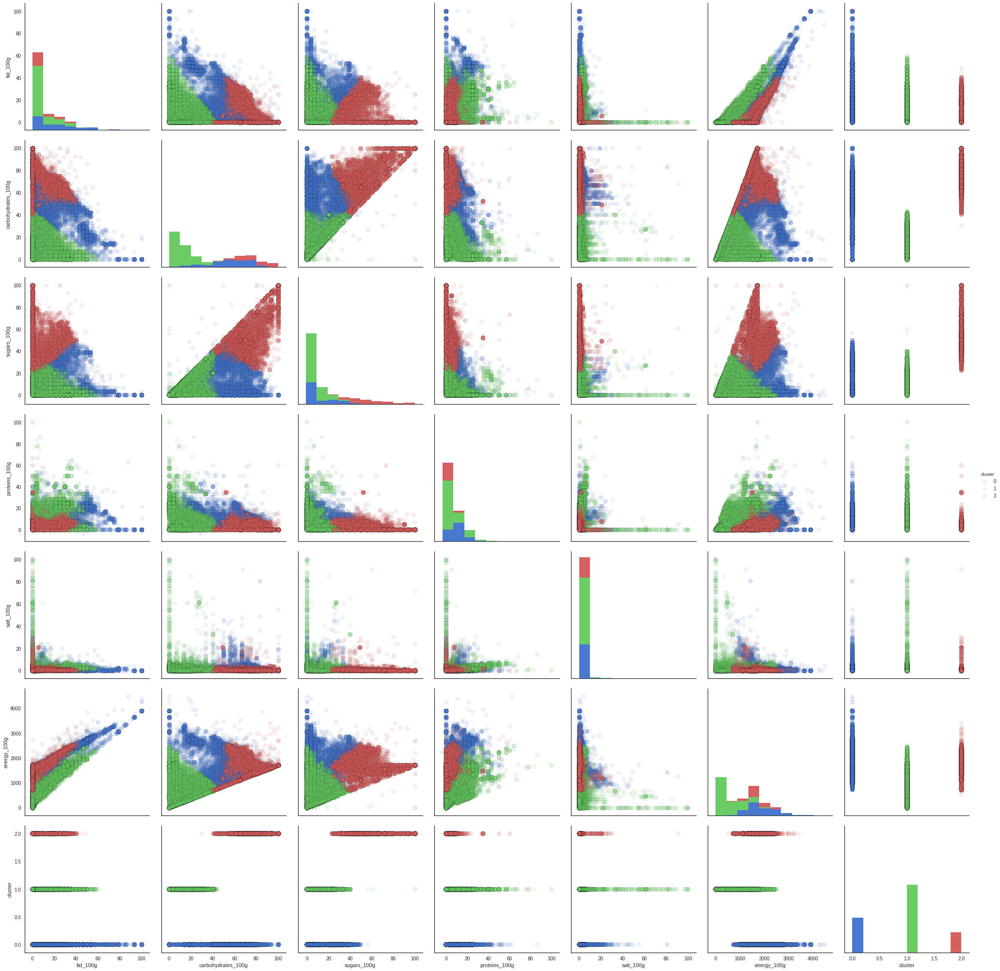

In [0]:
import seaborn as sns
sns.pairplot(df_cluster_features, hue="cluster",
plot_kws = {'alpha': 0.1, 's': 80, 'edgecolor': 'k'},
             size = 4)

### 3D ClusterPlot

#### Protein-Fat-Carb 3D Plot

In [0]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["fat_100g"],
    y=df["carbohydrates_100g"],
    z=df["proteins_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Protein-Fat-Carb:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Fat Content-100g'),
        yaxis = dict(title="Y:  Carbohydrate Content-100g"),
        zaxis = dict(title="Z:  Protein Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

#### Sugar-Fat-Carb-3D Plot

In [0]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
enable_plotly_in_cell()


trace1 = go.Scatter3d(
    x=df["sugars_100g"],
    y=df["carbohydrates_100g"],
    z=df["fat_100g"],
    mode='markers',
    text=df["product"],
    marker=dict(
        size=12,
        color=df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="Sugar, Carb, Salt:  Food Energy Types",
    scene = dict(
        xaxis = dict(title='X: Sugar Content-100g'),
        yaxis = dict(title="Y: Carbohydrate Content-100g"),
        zaxis = dict(title="Z: Fat Content-100g"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

###Word Cloud

In [0]:
clusterOne = df[df.cluster ==0]
ONE_text = clusterOne['product'].values
len(ONE_text)


12683

In [0]:
clusterTWO = df[df.cluster ==1]
TWO_text = clusterTWO['product'].values
len(TWO_text)



24777

In [0]:
clusterTHR = df[df.cluster ==2]
THR_text = clusterTHR['product'].values
len(THR_text)




7566

Word Cloud of #1 Cluster

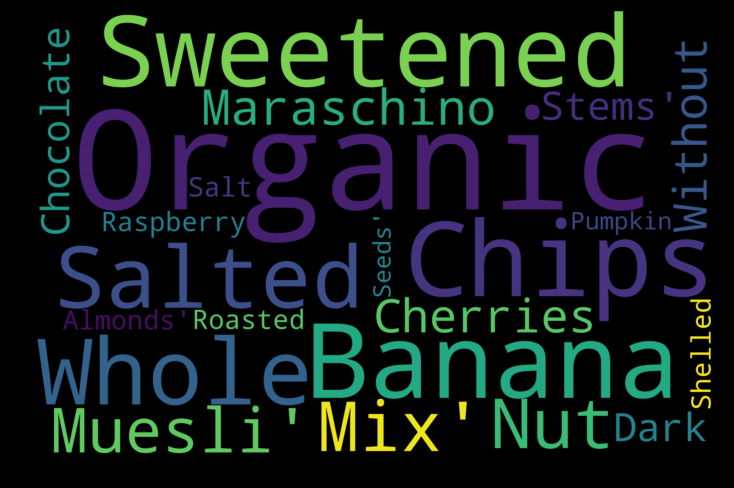

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(ONE_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

Word Cloud of #2 Cluster

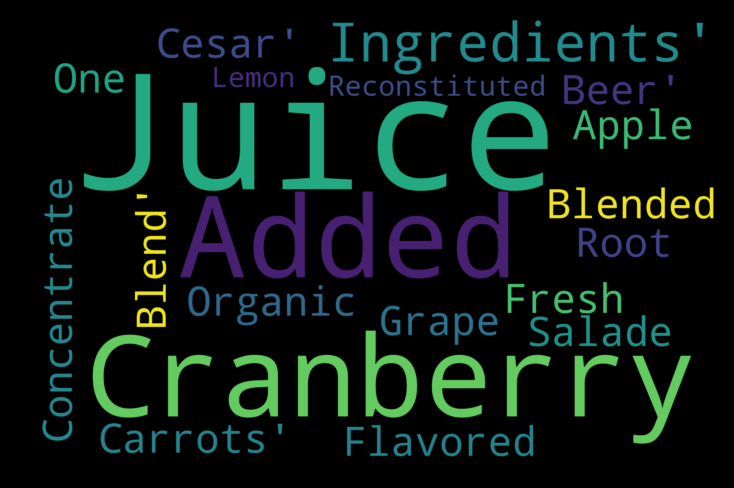

In [0]:
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(TWO_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

Word Cloud of #3 Cluster

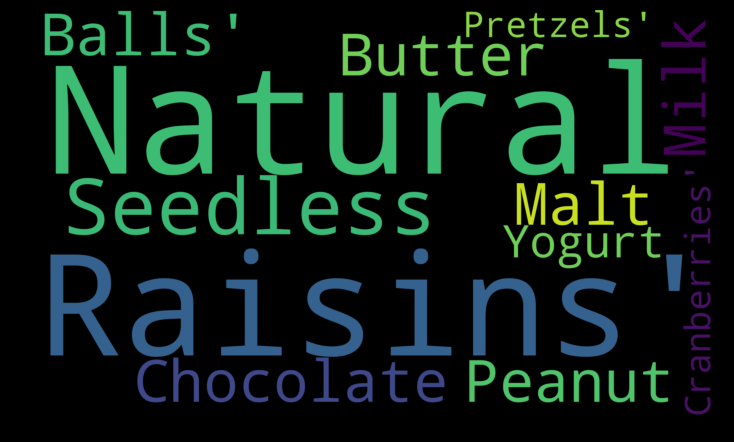

In [0]:
wordcloud = WordCloud(
    width = 5000,
    height = 3000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(THR_text))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()

#Conclusion

* The food is clustered into three clusters: 
 *   Energy provider: High fat and energy
 *   Protein provider: High protein, low carbohydrate, fat and sugar
 *   Calories provider: High carbohydrate, sugar
  
* Among all the variables, there are obvious positive relationship between energy and sugar, carbohydrate, fat and between sugar and carbohydrate; while protein and salt do not have obvious relationship with other variables.

* For each variable, salt is not a strong cluster driver, since most salt amount is overall small in most food.

* Even there are obvious relationship among variables, PCA does not work well, only very small percentage of variance remained in principle components  calculated.

